In [1]:
import sys
import logging
from uuid import UUID

import emission.core.get_database as edb
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import datetime as pydt
import emission.storage.timeseries.abstract_timeseries as esta
import emission.net.usercache.abstract_usercache as enua
import numpy as np

logging.getLogger().setLevel(logging.DEBUG)
logging.debug(sys.path)

iphone_ids = [UUID("079e0f1a-c440-3d7c-b0e7-de160f748e35"), UUID("c76a0487-7e5a-3b17-a449-47be666b36f6"), 
              UUID("c528bcd2-a88b-3e82-be62-ef4f2396967a"), UUID("95e70727-a04e-3e33-b7fe-34ab19194f8b")]
android_ids = [UUID("e471711e-bd14-3dbe-80b6-9c7d92ecc296"), UUID("fd7b4c2e-2c8b-3bfa-94f0-d1e3ecbd5fb7"),
               UUID("86842c35-da28-32ed-a90e-2da6663c5c73"), UUID("3bc0f91f-7660-34a2-b005-5c399598a369")]

In [2]:
list(edb.get_timeseries_db().find({"metadata.key": "config/sensor_config", "data.battery_status": {"$exists": True}}).sort("metadata.write_ts").limit(10))

[{u'_id': ObjectId('56fadecd88f66341cb3618c9'),
  u'data': {u'android_health': u'GOOD',
   u'android_plugged': u'USB',
   u'android_technology': u'Li-ion',
   u'android_temperature': 226,
   u'android_voltage': 226,
   u'battery_level_pct': 100,
   u'battery_status': 5},
  u'metadata': {u'key': u'config/sensor_config',
   u'platform': u'android',
   u'read_ts': 1459281599.629,
   u'time_zone': u'America/Los_Angeles',
   u'type': u'sensor-data',
   u'write_fmt_time': u'2016-03-29T11:56:24.694000-07:00',
   u'write_local_dt': datetime.datetime(2016, 3, 29, 11, 56, 24, 694000),
   u'write_ts': 1459277784.694},
  u'user_id': UUID('e471711e-bd14-3dbe-80b6-9c7d92ecc296')},
 {u'_id': ObjectId('56faecf288f66323bcc68ee9'),
  u'data': {u'android_health': u'GOOD',
   u'android_plugged': u'USB',
   u'android_technology': u'Li-ion',
   u'android_temperature': 197,
   u'android_voltage': 197,
   u'battery_level_pct': 100,
   u'battery_status': 2},
  u'metadata': {u'key': u'config/sensor_config',
   

In [3]:
iphone_ts = map(lambda u: esta.TimeSeries.get_time_series(u), iphone_ids)
android_ts = map(lambda u: esta.TimeSeries.get_time_series(u), android_ids)

In [4]:
ranges_df = pd.read_csv("../results_spring_2016/ranges.csv")

In [5]:
ranges_df

,start_ts,start_fmt_time,end_ts,end_fmt_time,state,android_regime,ios_regime
0,1.459279e+09,2016-03-29T12:17:14.700000-07:00,1.459288e+09,2016-03-29T14:46:54.916000-07:00,moving,high+1sec,best+1m
1,1.459288e+09,2016-03-29T14:46:54.916000-07:00,1.459301e+09,2016-03-29T18:30:30.685000-07:00,loitering,high+1sec,best+1m
2,1.459301e+09,2016-03-29T18:30:54.916000-07:00,1.459302e+09,2016-03-29T18:42:30.685000-07:00,moving,high+1sec,best+1m
3,1.459302e+09,2016-03-29T18:42:30.685000-07:00,1.459311e+09,2016-03-29T21:06:30.275000-07:00,moving,high+1sec,best+1m
4,1.459311e+09,2016-03-29T21:06:30.275000-07:00,1.459343e+09,2016-03-30T06:00:09.654643-07:00,stationary,high+1sec,best+1m
5,1.459343e+09,2016-03-30T06:00:09.654643-07:00,1.459354e+09,2016-03-30T09:00:13.859000-07:00,charging-or-full,high+1sec,best+1m
6,1.459354e+09,2016-03-30T09:00:13.859000-07:00,1.459372e+09,2016-03-30T14:01:58.965395-07:00,charging-or-full,high-v-balanced+1sec-v-30sec,best-v-10m+1m-v-30m
7,1.459372e+09,2016-03-30T14:01:58.965395-07:00,1.459372e+09,2016-03-30T14:13:55.019000-07:00,loitering,high-v-balanced+1sec-v-30sec,best-v-10m+1m-v-30m
8,1.459372e+09,2016-03-30T14:13:55.019000-07:00,1.459373e+09,2016-03-30T14:24:42.464000-07:00,moving,high-v-balanced+1sec-v-30sec,best-v-10m+1m-v-30m
9,1.459373e+09,2016-03-30T14:24:42.464000-07:00,1.459376e+09,2016-03-30T15:21:27.670000-07:00,loitering,high-v-balanced+1sec-v-30sec,best-v-10m+1m-v-30m


In [6]:
regime_grouped_ranges_df = ranges_df.groupby(['state', 'android_regime', 'ios_regime'])

In [7]:
invalid_df = pd.read_csv("../results_spring_2016/invalid.csv")

In [8]:
invalid_df

,platform,key,start_ts,start_fmt_time,end_ts,end_fmt_time
0,android,background/battery,1.459354e+09,2016-03-30T09:00:08.640000-07:00,1.459436e+09,2016-03-31T07:57:22.005000-07:00


In [9]:
def get_points_from_ts_for_range(ts, start_ts, end_ts):
    return ts.get_data_df("background/location", enua.UserCache.TimeQuery('write_ts', start_ts, end_ts))

In [10]:
def get_points_for_range(ts, range_df):
    points_range_df = map(lambda row: get_points_from_ts_for_range(ts, row['start_ts'], row['end_ts']), range_df.to_dict('records'))
    return points_range_df

In [11]:
def get_points_for_group(ts_list, range_df):
    return map(lambda ts: get_points_for_range(ts, range_df), ts_list)

In [12]:
iphone_range_phone_location_df_list = []
for key, df in regime_grouped_ranges_df:
    if key[0] == 'moving' and key[1] == 'high+1sec':
        duration = df.end_ts - df.start_ts
        df = df[duration > 60 * 60]
        # one row for each phone
        # each row contains len(stationary ranges) dataframes
        phone_range_location_df_list = get_points_for_group(iphone_ts, df)
        # one row for each dataframe row
        # each row contains nPhones dataframe (basically, a transpose of the prior matrix)
        for i in range(len(df)):
            curr_range_list = []
            for j in range(len(iphone_ts)):
                curr_range_list.append(phone_range_location_df_list[j][i])
            iphone_range_phone_location_df_list.append(curr_range_list)
        # iphone_range_location_df_list = np.array(phone_range_location_df_list).tranpose().to_list()

DEBUG:root:curr_query = {'$or': [{'metadata.key': 'background/location'}], 'metadata.write_ts': {'$gte': 1459279034.7, '$lt': 1459288014.9160001}, 'user_id': UUID('079e0f1a-c440-3d7c-b0e7-de160f748e35')}, sort_key = metadata.write_ts
DEBUG:root:Found 1522 results
DEBUG:root:curr_query = {'$or': [{'metadata.key': 'background/location'}], 'metadata.write_ts': {'$gte': 1459302150.685, '$lt': 1459310790.275}, 'user_id': UUID('079e0f1a-c440-3d7c-b0e7-de160f748e35')}, sort_key = metadata.write_ts
DEBUG:root:Found 4625 results
DEBUG:root:curr_query = {'$or': [{'metadata.key': 'background/location'}], 'metadata.write_ts': {'$gte': 1459279034.7, '$lt': 1459288014.9160001}, 'user_id': UUID('c76a0487-7e5a-3b17-a449-47be666b36f6')}, sort_key = metadata.write_ts
DEBUG:root:Found 1712 results
DEBUG:root:curr_query = {'$or': [{'metadata.key': 'background/location'}], 'metadata.write_ts': {'$gte': 1459302150.685, '$lt': 1459310790.275}, 'user_id': UUID('c76a0487-7e5a-3b17-a449-47be666b36f6')}, sort_ke

In [4]:
android_range_phone_location_df_list = []
for key, df in regime_grouped_ranges_df:
    if key[0] == 'moving' and key[1] == 'high+1sec':
        duration = df.end_ts - df.start_ts
        df = df[duration > 60 * 60]
        # one row for each phone
        # each row contains len(stationary ranges) dataframes
        phone_range_location_df_list = get_points_for_group(android_ts, df)
        # one row for each dataframe row
        # each row contains nPhones dataframe (basically, a transpose of the prior matrix)
        for i in range(len(df)):
            curr_range_list = []
            for j in range(len(iphone_ts)):
                curr_range_list.append(phone_range_location_df_list[j][i])
            android_range_phone_location_df_list.append(curr_range_list)
        # iphone_range_location_df_list = np.array(phone_range_location_df_list).tranpose().to_list()

NameError: name 'regime_grouped_ranges_df' is not defined

In [14]:
print len(iphone_range_phone_location_df_list), len(android_range_phone_location_df_list)

2 2


In [7]:
import emission.analysis.plotting.geojson.geojson_feature_converter as gfc
import emission.analysis.plotting.leaflet_osm.our_plotter as lo
import emission.analysis.plotting.leaflet_osm.ipython_helper as ipy

ImportError: No module named plugin

In [18]:
ipy.inline_maps([np.array(map(lambda loc_df: lo.get_maps_for_geojson_unsectioned([gfc.get_feature_list_from_df(loc_df)]),
                    iphone_range_phone_location_df_list[0])).flatten().tolist()])

DEBUG:root:Getting midpoint of (-122.3869805877305, 37.60022005535438) and (-122.2590507847464, 37.87539051849197)


Found 1522 points
Found 1712 points

DEBUG:root:Getting midpoint of (-122.4062107690819, 37.62165287513064) and (-122.2590255552179, 37.87538071166526)



Found 1673 points

DEBUG:root:Getting midpoint of (-122.4437901594938, 37.66434492798264) and (-122.2590368707872, 37.87539567336242)



Found 1463 points

DEBUG:root:Getting midpoint of (-122.4674524740525, 37.70795383028472) and (-122.2590396368152, 37.87539843939047)


In [24]:
ipy.inline_maps([np.array(map(lambda loc_df: lo.get_maps_for_geojson_unsectioned([gfc.get_feature_list_from_df(loc_df)]),
                    android_range_phone_location_df_list[0])).flatten().tolist()])

DEBUG:root:Getting midpoint of (-122.0842331, 37.3911322) and (-122.2589767, 37.875392)


Found 6192 points
Found 5586 points

DEBUG:root:Getting midpoint of (-122.0849953, 37.3914291) and (-122.2590005, 37.8754026)



Found 6501 points

DEBUG:root:Getting midpoint of (-122.0849453, 37.3914196) and (-122.2590121, 37.8753505)



Found 6837 points

DEBUG:root:Getting midpoint of (-122.0849694, 37.3914352) and (-122.2590091, 37.8753793)


In [25]:
ipy.inline_maps([np.array(map(lambda loc_df: lo.get_maps_for_geojson_unsectioned([gfc.get_feature_list_from_df(loc_df)]),
                    iphone_range_phone_location_df_list[1])).flatten().tolist()])

DEBUG:root:Getting midpoint of (-122.2632742581165, 37.87264586429845) and (-122.0865038597231, 37.3910302995121)


Found 4625 points
Found 4635 points

DEBUG:root:Getting midpoint of (-122.2632610147095, 37.87258685570012) and (-122.0865347889458, 37.39110883794482)



Found 4732 points

DEBUG:root:Getting midpoint of (-122.2632356175429, 37.87258061118226) and (-122.0865186118726, 37.39094622902329)



Found 4789 points

DEBUG:root:Getting midpoint of (-122.2632679716891, 37.87259963810246) and (-122.0865693223868, 37.39109324760492)


In [26]:
ipy.inline_maps([np.array(map(lambda loc_df: lo.get_maps_for_geojson_unsectioned([gfc.get_feature_list_from_df(loc_df)]),
                    android_range_phone_location_df_list[1])).flatten().tolist()])

DEBUG:root:Getting midpoint of (-122.2632396, 37.872595) and (-122.0865639, 37.3910139)


Found 6437 points
Found 6397 points

DEBUG:root:Getting midpoint of (-122.2632457, 37.872579) and (-122.0864805, 37.3910232)



Found 6440 points

DEBUG:root:Getting midpoint of (-122.263242, 37.8725682) and (-122.086499, 37.3910132)



Found 6456 points

DEBUG:root:Getting midpoint of (-122.2632432, 37.8725851) and (-122.0865082, 37.391035)


In [25]:
iphone_last = map(lambda df: df.tail(500), iphone_range_phone_location_df_list[0])
iphone_first = map(lambda df: df.head(200), iphone_range_phone_location_df_list[1])
android_last = map(lambda df: df.tail(500), android_range_phone_location_df_list[0])
android_first = map(lambda df: df.head(200), android_range_phone_location_df_list[1])

In [27]:
ipy.inline_maps([np.array(map(lambda loc_df: lo.get_maps_for_geojson_unsectioned([gfc.get_feature_list_from_df(loc_df)]),
                    iphone_last)).flatten().tolist(),
                 np.array(map(lambda loc_df: lo.get_maps_for_geojson_unsectioned([gfc.get_feature_list_from_df(loc_df)]),
                    iphone_first)).flatten().tolist(),
                 np.array(map(lambda loc_df: lo.get_maps_for_geojson_unsectioned([gfc.get_feature_list_from_df(loc_df)]),
                    android_first)).flatten().tolist(),
                 np.array(map(lambda loc_df: lo.get_maps_for_geojson_unsectioned([gfc.get_feature_list_from_df(loc_df)]),
                    android_last)).flatten().tolist()])

DEBUG:root:Getting midpoint of (-122.2646586132443, 37.87179531067412) and (-122.2590507847464, 37.87539051849197)


Found 500 points
Found 500 points

DEBUG:root:Getting midpoint of (-122.2644387559241, 37.87178650967579) and (-122.2590255552179, 37.87538071166526)



Found 500 points

DEBUG:root:Getting midpoint of (-122.2643158772236, 37.87184878721635) and (-122.2590368707872, 37.87539567336242)



Found 500 points

DEBUG:root:Getting midpoint of (-122.2641831916964, 37.87178227681468) and (-122.2590396368152, 37.87539843939047)



Found 200 points

DEBUG:root:Getting midpoint of (-122.2632742581165, 37.87264586429845) and (-122.2663463094479, 37.87158903203706)



Found 200 points

DEBUG:root:Getting midpoint of (-122.2632610147095, 37.87258685570012) and (-122.2661955190099, 37.87156091075192)



Found 200 points

DEBUG:root:Getting midpoint of (-122.2632356175429, 37.87258061118226) and (-122.2661619075781, 37.87157264541636)



Found 200 points

DEBUG:root:Getting midpoint of (-122.2632679716891, 37.87259963810246) and (-122.266169367472, 37.87155944391887)



Found 200 points

DEBUG:root:Getting midpoint of (-122.2632396, 37.872595) and (-122.2660327, 37.8715476)



Found 200 points

DEBUG:root:Getting midpoint of (-122.2632457, 37.872579) and (-122.2659952, 37.8715892)



Found 200 points

DEBUG:root:Getting midpoint of (-122.263242, 37.8725682) and (-122.2660226, 37.8715999)



Found 200 points

DEBUG:root:Getting midpoint of (-122.2632432, 37.8725851) and (-122.2659846, 37.8716052)



Found 500 points

DEBUG:root:Getting midpoint of (-122.2631686, 37.8726239) and (-122.2589767, 37.875392)



Found 500 points

DEBUG:root:Getting midpoint of (-122.2631624, 37.8725842) and (-122.2590005, 37.8754026)



Found 500 points

DEBUG:root:Getting midpoint of (-122.2631916, 37.8725901) and (-122.2590121, 37.8753505)



Found 500 points

DEBUG:root:Getting midpoint of (-122.2631816, 37.8725867) and (-122.2590091, 37.8753793)


In [20]:
def get_interpolated_df(sensor_df, xnew):
    local_dt_new = map(pydt.datetime.fromtimestamp, xnew)
    fmt_time_new = map(lambda dt: dt.isoformat(), local_dt_new)
    interpolated_series = get_interpolated(sensor_df.ts, sensor_df.battery_level_pct, xnew)
    # print "interpolated_series = %s" % interpolated_series
    interpolated_df = pd.DataFrame(data={'ts': xnew, 'metadata_write_ts': xnew, 'local_dt': local_dt_new, 'fmt_time': fmt_time_new, 'battery_level_pct': interpolated_series})
    return interpolated_df

In [21]:
xnew = np.arange(ranges_df.iloc[0].start_ts, ranges_df.iloc[-1].end_ts, 15 * 60) # 30 minutes

In [22]:
iphone_battery_interp_df = map(lambda df: get_interpolated_df(df, xnew), iphone_battery_df)
android_battery_interp_df = map(lambda df: get_interpolated_df(df, xnew), android_battery_df)

NameError: name 'iphone_battery_interp_df' is not defined

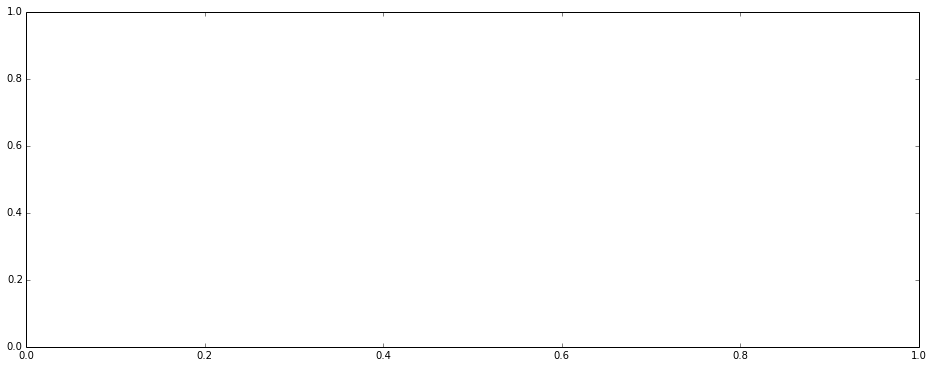

In [27]:
(ifig, iaxes2d) = plt.subplots(ncols=1, nrows=1, figsize=(16,6))
iaxes = iaxes2d
for i, df in enumerate(iphone_battery_interp_df):
    print "About to plot %d" % i
    df.plot(x='local_dt', y='latitude', ax=iaxes, label="phone-%s" % i)

About to plot 0
About to plot 1
About to plot 2
About to plot 3


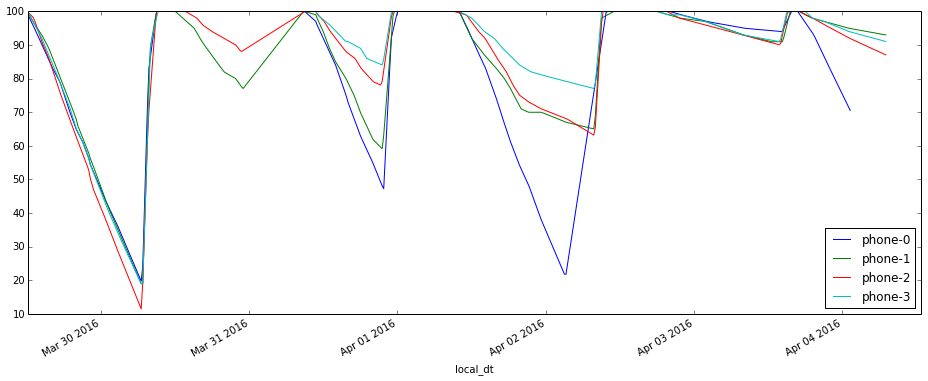

In [24]:
(afig, aaxes2d) = plt.subplots(ncols=1, nrows=1, figsize=(16,6))
aaxes = aaxes2d
for i, df in enumerate(android_battery_interp_df):
    print "About to plot %d" % i
    df.plot(x='local_dt', y='battery_level_pct', ax=aaxes, label="phone-%s" % i)